In [1]:
import cv2
import matplotlib.pyplot as plt
import os
import numpy as np

In [2]:
# Wczytanie zdjęcia popiersie.jpg
popiersie = cv2.imread("popiersie.jpg", cv2.IMREAD_GRAYSCALE)

# SIFT

In [4]:
sift = cv2.SIFT_create()

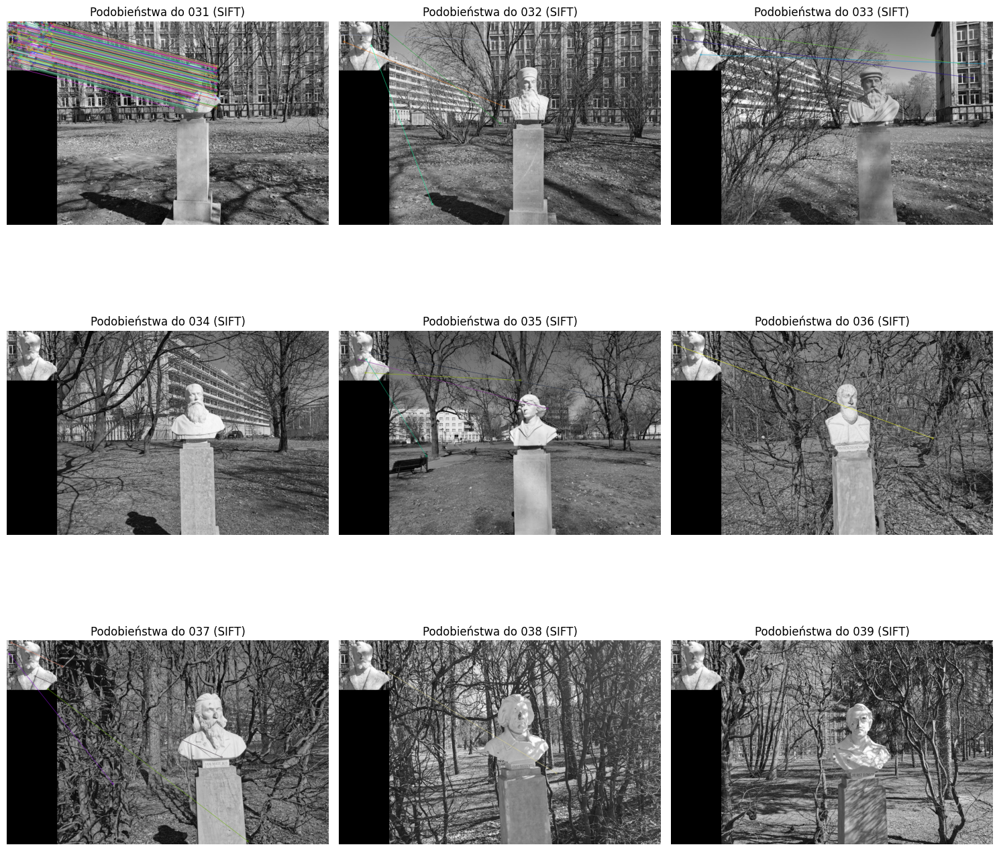

In [5]:
reference_keypoints, reference_descriptors = sift.detectAndCompute(popiersie, None)

results = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    keypoints, descriptors = sift.detectAndCompute(gray, None)
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(reference_descriptors, descriptors, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    results.append((gray, keypoints, good_matches))

num_cols = 3
num_rows = (len(results) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(popiersie, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (SIFT)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('sift.jpg', bbox_inches='tight')
plt.show()

In [6]:
obrocone = np.rot90(popiersie, 2)

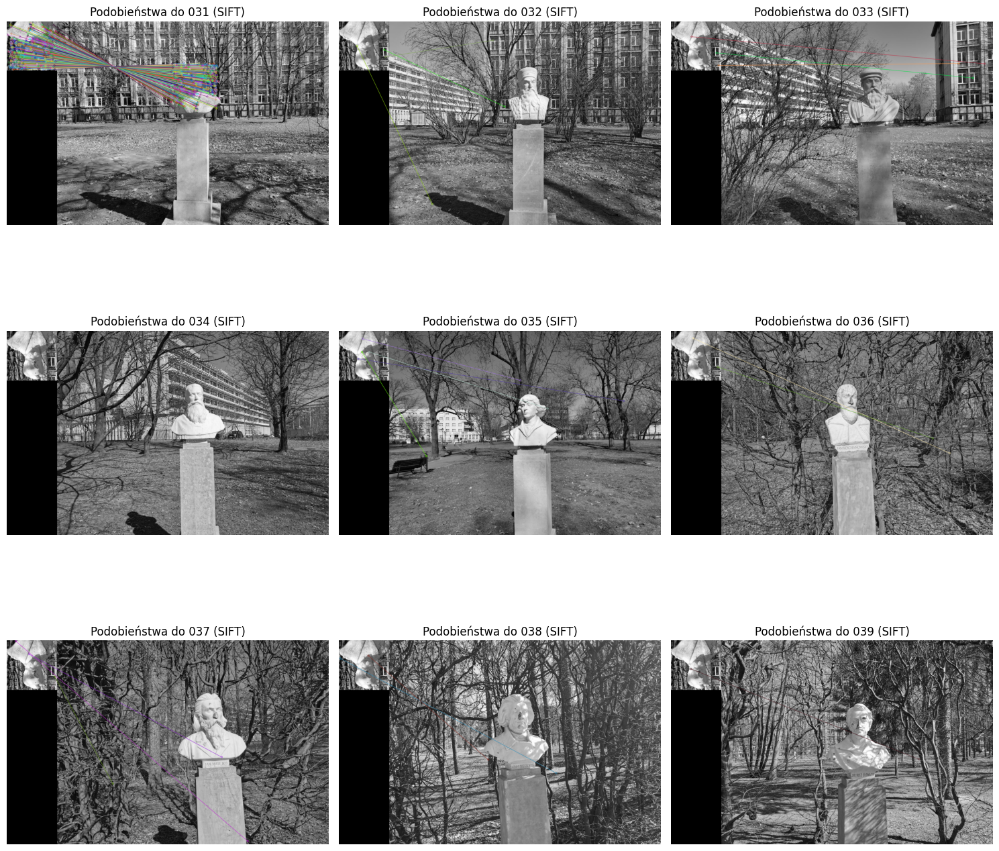

In [7]:
reference_keypoints, reference_descriptors = sift.detectAndCompute(obrocone, None)

results = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    keypoints, descriptors = sift.detectAndCompute(gray, None)
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(reference_descriptors, descriptors, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    results.append((gray, keypoints, good_matches))

num_cols = 3
num_rows = (len(results) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(obrocone, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (SIFT)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('obrocone_sift.jpg', bbox_inches='tight')
plt.show()

# ORB

In [9]:
orb = cv2.ORB_create()

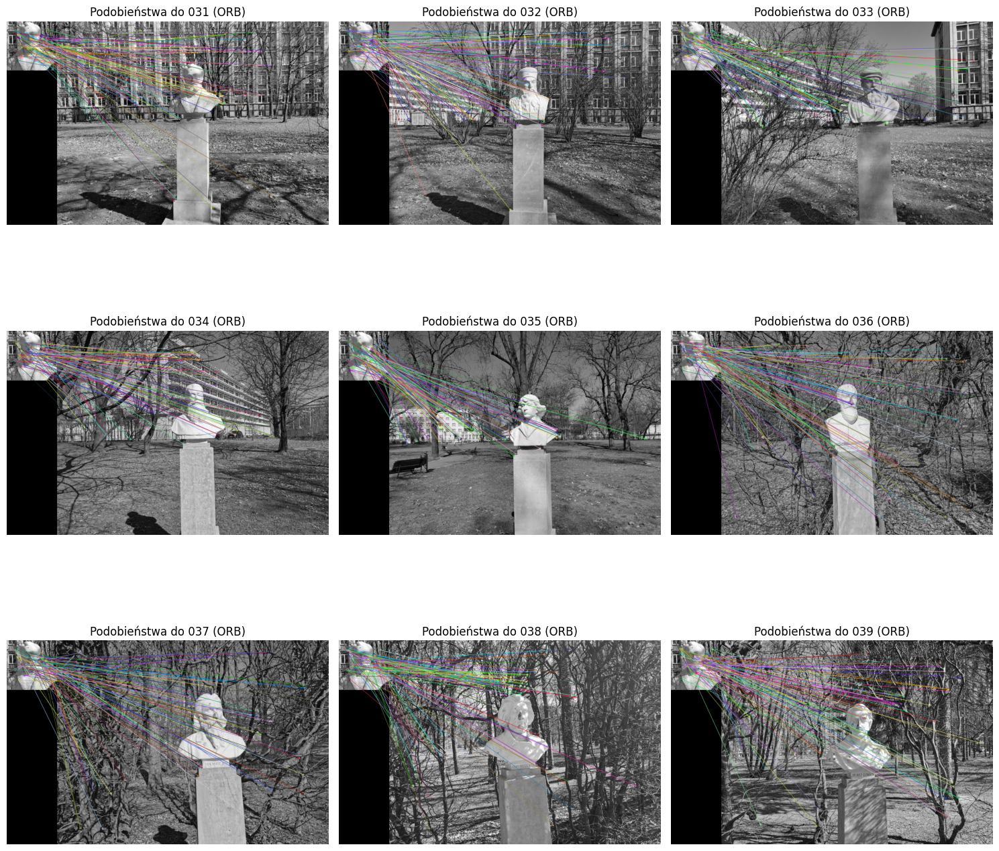

In [10]:
# Zmodyfikuj część dotyczącą detekcji i obliczania deskryptorów dla ORB
reference_keypoints, reference_descriptors = orb.detectAndCompute(popiersie, None)

results_orb = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    keypoints, descriptors = orb.detectAndCompute(gray, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(reference_descriptors, descriptors)
    good_matches = sorted(matches, key=lambda x: x.distance)[:int(len(matches)*0.75)]
    results_orb.append((gray, keypoints, good_matches))

# Wyświetlanie wyników dla ORB
num_cols = 3
num_rows = (len(results_orb) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results_orb, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(popiersie, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (ORB)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('orb.jpg', bbox_inches='tight')
plt.show()

In [11]:
obrocone = np.rot90(popiersie, 2)

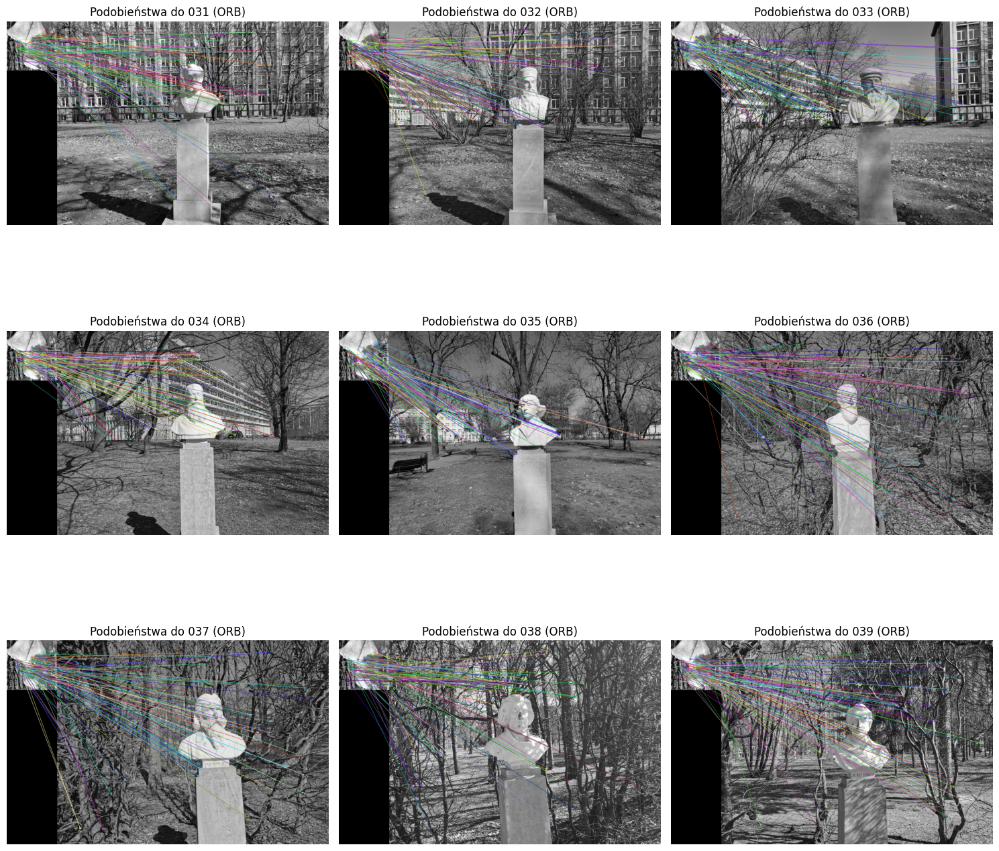

In [12]:
# Zmodyfikuj część dotyczącą detekcji i obliczania deskryptorów dla ORB
reference_keypoints, reference_descriptors = orb.detectAndCompute(obrocone, None)

results_orb = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    keypoints, descriptors = orb.detectAndCompute(gray, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(reference_descriptors, descriptors)
    good_matches = sorted(matches, key=lambda x: x.distance)[:int(len(matches)*0.75)]
    results_orb.append((gray, keypoints, good_matches))

# Wyświetlanie wyników dla ORB
num_cols = 3
num_rows = (len(results_orb) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results_orb, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(obrocone, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (ORB)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('obrocone_orb.jpg', bbox_inches='tight')
plt.show()

# BRISK

In [14]:
brisk = cv2.BRISK_create()

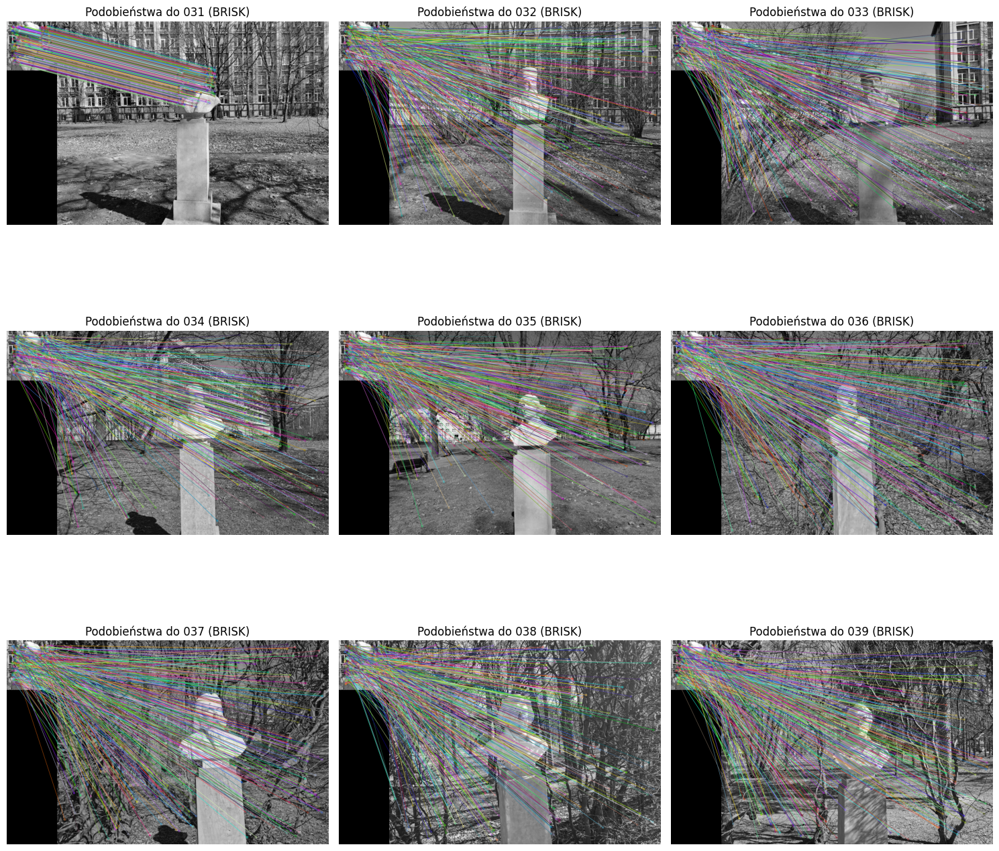

In [15]:
# Zmodyfikuj część dotyczącą detekcji i obliczania deskryptorów dla BRISK
reference_keypoints, reference_descriptors = brisk.detectAndCompute(popiersie, None)

results_brisk = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    keypoints, descriptors = brisk.detectAndCompute(gray, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(reference_descriptors, descriptors)
    good_matches = sorted(matches, key=lambda x: x.distance)[:int(len(matches)*0.75)]
    results_brisk.append((gray, keypoints, good_matches))

# Wyświetlanie wyników dla BRISK
num_cols = 3
num_rows = (len(results_brisk) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results_brisk, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(popiersie, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (BRISK)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('brisk.jpg', bbox_inches='tight')
plt.show()

In [16]:
obrocone = np.rot90(popiersie, 2)

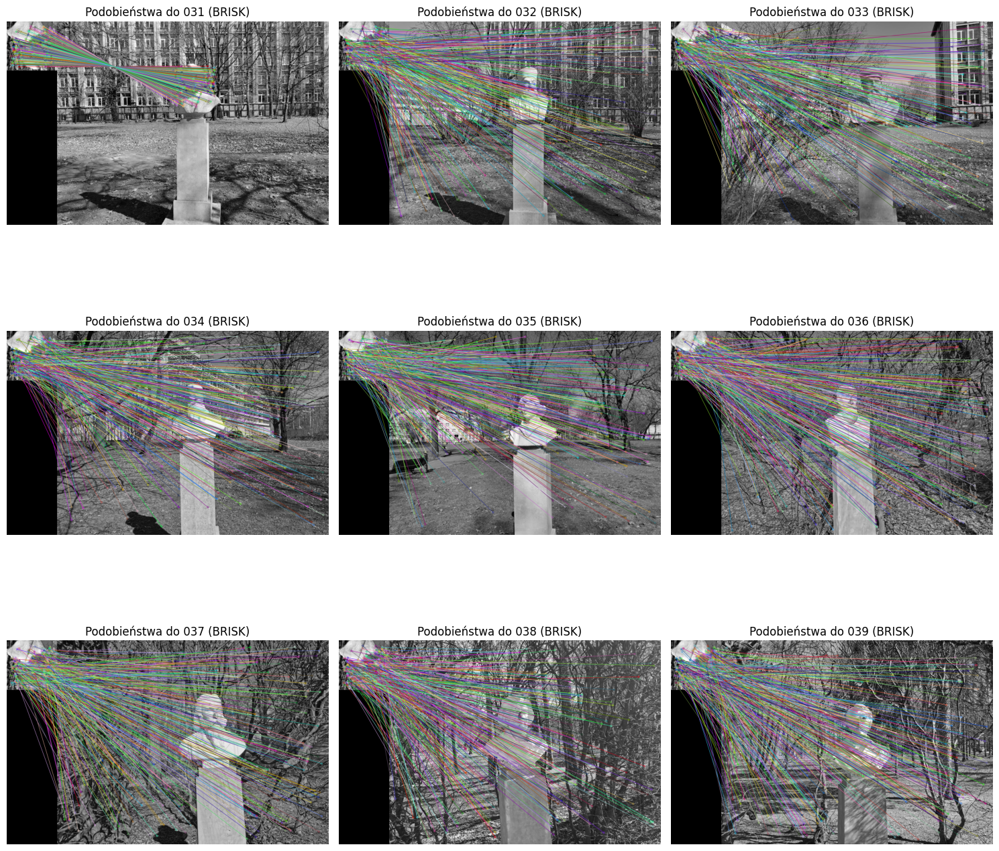

In [17]:
# Zmodyfikuj część dotyczącą detekcji i obliczania deskryptorów dla BRISK
reference_keypoints, reference_descriptors = brisk.detectAndCompute(obrocone, None)

results_brisk = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    keypoints, descriptors = brisk.detectAndCompute(gray, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(reference_descriptors, descriptors)
    good_matches = sorted(matches, key=lambda x: x.distance)[:int(len(matches)*0.75)]
    results_brisk.append((gray, keypoints, good_matches))

# Wyświetlanie wyników dla BRISK
num_cols = 3
num_rows = (len(results_brisk) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results_brisk, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(obrocone, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (BRISK)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('obrocone_brisk.jpg', bbox_inches='tight')
plt.show()

# FAST

In [19]:
fast = cv2.FastFeatureDetector_create()

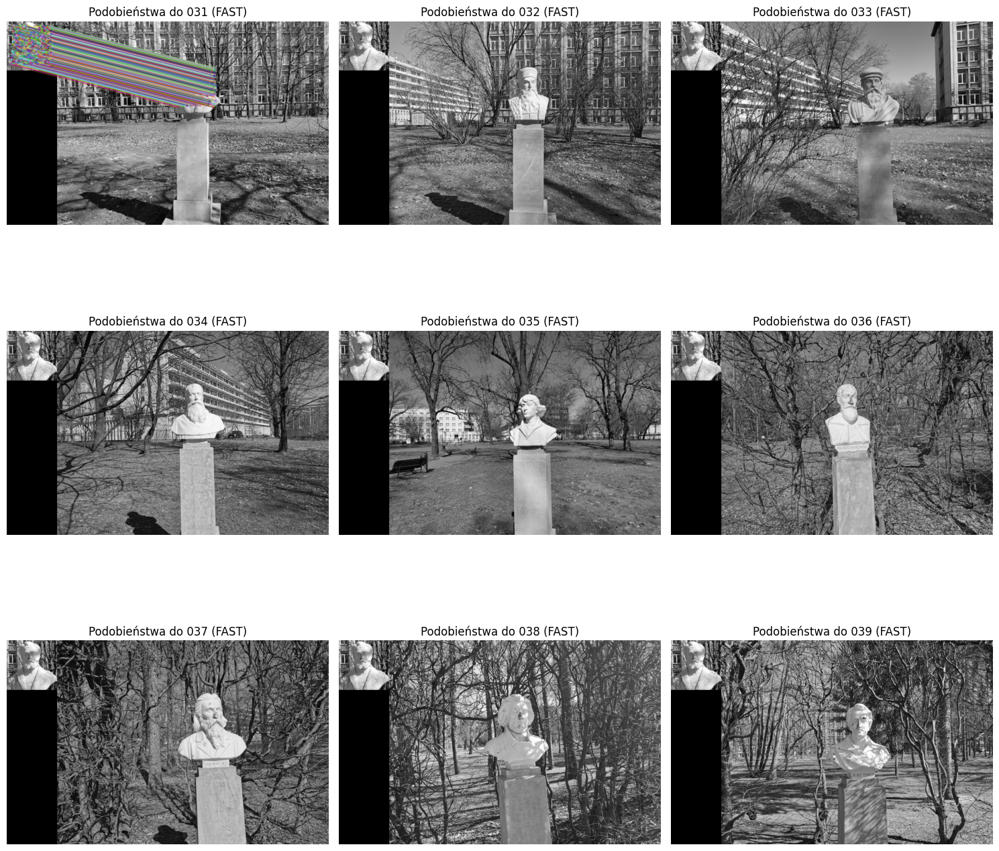

In [20]:
# Znajdowanie punktów charakterystycznych dla obrazu referencyjnego
reference_keypoints = fast.detect(popiersie, None)
reference_keypoints, reference_descriptors = sift.compute(popiersie, reference_keypoints)

results_fast = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    
    # Znajdowanie punktów charakterystycznych dla obrazu z bazy QBIC
    keypoints = fast.detect(gray, None)
    keypoints, descriptors = sift.compute(gray, keypoints)
    
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(reference_descriptors, descriptors, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    results_fast.append((gray, keypoints, good_matches))

# Wyświetlanie wyników dla FAST
num_cols = 3
num_rows = (len(results_fast) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results_fast, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(popiersie, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (FAST)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('fast.jpg', bbox_inches='tight')
plt.show()

In [21]:
obrocone = np.rot90(popiersie, 2)

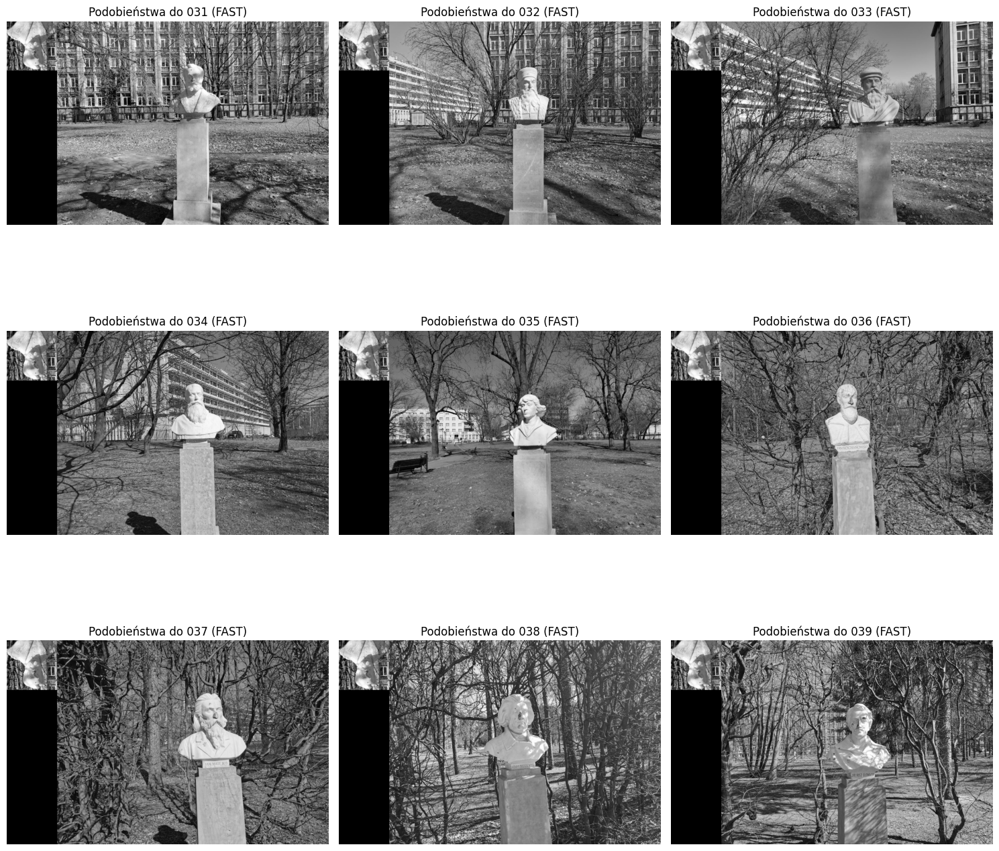

In [22]:
# Znajdowanie punktów charakterystycznych dla obrazu referencyjnego
reference_keypoints = fast.detect(obrocone, None)
reference_keypoints, reference_descriptors = sift.compute(obrocone, reference_keypoints)

results_fast = []
for i in range(81, 90):
    filename = f"QBIC/image{i:03d}.jpg"
    gray = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    
    # Znajdowanie punktów charakterystycznych dla obrazu z bazy QBIC
    keypoints = fast.detect(gray, None)
    keypoints, descriptors = sift.compute(gray, keypoints)
    
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(reference_descriptors, descriptors, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    results_fast.append((gray, keypoints, good_matches))

# Wyświetlanie wyników dla FAST
num_cols = 3
num_rows = (len(results_fast) + num_cols - 1) // num_cols
plt.figure(figsize=(15, 5*num_rows))
for i, (image, keypoints, good_matches) in enumerate(results_fast, start=1):
    plt.subplot(num_rows, num_cols, i)
    img_matches = cv2.drawMatches(obrocone, reference_keypoints, image, keypoints, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Podobieństwa do {i+30:03d} (FAST)")
    plt.axis("off")
plt.tight_layout()
plt.savefig('obrocone_fast.jpg', bbox_inches='tight')
plt.show()